In [6]:
# import libraries
import pandas as pd
import geopandas as gpd 

import json 

from shapely.geometry import LineString

from traclus import traclus as tr
from matplotlib import pyplot as plt
import numpy as np

import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import contextily as ctx
import json
from shapely.geometry import LineString

In [7]:
# Variables globales
nrows = 50
# Ruta del archivo CSV
filename = "../train_data/taxis_trajectory/train.csv"

In [8]:
# Leer el archivo CSV
df = pd.read_csv(filename, nrows=nrows, sep=",", low_memory=False)

In [9]:
# Convertir las polilíneas de JSON a listas de coordenadas
df['POLYLINE'] = df['POLYLINE'].apply(lambda x: json.loads(x) if pd.notnull(x) else None)

# Filtrar filas con polilíneas vacías o nulas
df = df[df['POLYLINE'].apply(lambda x: x is not None and len(x) > 0)]

In [10]:
# Preparar las trayectorias para TRACLUS
trayectorias = [np.array(polyline) for polyline in df['POLYLINE']]

# Ejecutar TRACLUS
out = tr.traclus(trayectorias, min_samples=5, progress_bar=True)
partitions, segments, dist_matrix, clusters, cluster_assignments, representative_trajectories = out

Partitioning trajectories...
Trajectory 4/50

c:\Users\Álvaro\AppData\Local\Programs\Python\Python311\Lib\site-packages\traclus\traclus.py:255: RuntimeWarning: divide by zero encountered in log2
  LH += np.log2(d_euclidean(trajectory[i], trajectory[i+1]))


Trajectory 50/50
Converting partitioned trajectories to segments...
Grouping partitions...: 1/488

Getting representative trajectories...



c:\Users\Álvaro\AppData\Local\Programs\Python\Python311\Lib\site-packages\traclus\traclus.py:449: UserWarning: WARNING: No representative points were found.
  warnings.warn("WARNING: No representative points were found.")


In [11]:
""" trayectorias """

' trayectorias '

In [12]:
""" print("Particiones: ", partitions) """

' print("Particiones: ", partitions) '

In [13]:
""" print("Segmentos: ", segments) """

' print("Segmentos: ", segments) '

In [14]:
""" print("Matriz de distancias: ", dist_matrix) """

' print("Matriz de distancias: ", dist_matrix) '

In [15]:
""" print("Clusters: ", clusters) """

' print("Clusters: ", clusters) '

In [16]:
""" print("Asignaciones: ", cluster_assignments) """

' print("Asignaciones: ", cluster_assignments) '

In [17]:
""" print("Trayectorias representativas: ", representative_trajectories) """

' print("Trayectorias representativas: ", representative_trajectories) '

In [18]:
def plot_clusters_on_map(clusters, cluster_assignments, descart_minun_one=False):
    # Crear un GeoDataFrame vacío
    gdf = gpd.GeoDataFrame(columns=['geometry', 'cluster_id'])

    # Añadir cada segmento al GeoDataFrame
    for segment in clusters:
        for part, cluster_id in zip(segment , cluster_assignments):
            if descart_minun_one and cluster_id == -1:
                continue
                # Cada 'part' es un segmento dentro del cluster
            if isinstance(part, np.ndarray):  # Verificar si 'part' es un array de NumPy
                line = LineString(part)
                gdf = pd.concat([gdf, gpd.GeoDataFrame({'geometry': [line], 'cluster_id': [cluster_id]})], ignore_index=True)

    gdf.crs = "EPSG:4326"
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)

    if not gdf.empty:
        # Generar colores para cada cluster
        unique_clusters = gdf['cluster_id'].unique()
        colormap = plt.cm.tab20
        color_dict = {cid: colormap(i / len(unique_clusters)) for i, cid in enumerate(unique_clusters)}

        # Dibujar cada segmento según su cluster_id
        for _, row in gdf.iterrows():
            color = color_dict[row['cluster_id']]
            gdf.loc[gdf.index == _, 'geometry'].plot(ax=ax, linewidth=2, color=color)

        # Añadir leyenda        
        legend_elements = [Line2D([0], [0], color=color_dict[cid], lw=2, label=f'Cluster {cid}') for cid in unique_clusters]
        ax.legend(handles=legend_elements, loc='upper left')

        ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    else:
        print("No hay datos válidos para graficar.")

    ax.set_axis_off()
    plt.show()

In [27]:
def create_gdf(data):
    valid_geometries = [LineString(x) for x in data if len(x) > 1]
    gdf = gpd.GeoDataFrame(geometry=valid_geometries, crs='EPSG:4326')

    return gdf

In [28]:
def plot_map(data, color, data2=None, color2=None):
    gdf = create_gdf(data)
    if data2 is not None:
        gdf2 = create_gdf(data2)
    else:
        gdf2 = None

    # Visualizar en un mapa
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)
    gdf.plot(ax=ax, color=color, linewidth=2)
    if gdf2 is not None:
        gdf2.plot(ax=ax, color=color2, alpha=0.5, linewidth=1)

    # Añadir mapa base
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    # ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite)
    ax.set_axis_off()
    plt.show()

In [29]:
def plot_representation_colour(data):
    gdf = create_gdf(data)

    # Visualizar en un mapa
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)
    gdf.plot(ax=ax, cmap='tab20', linewidth=2)

    # Añadir mapa base
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=gdf.crs.to_string())
    # ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite)
    ax.set_axis_off()
    plt.show()

Visualizar datos en mapas

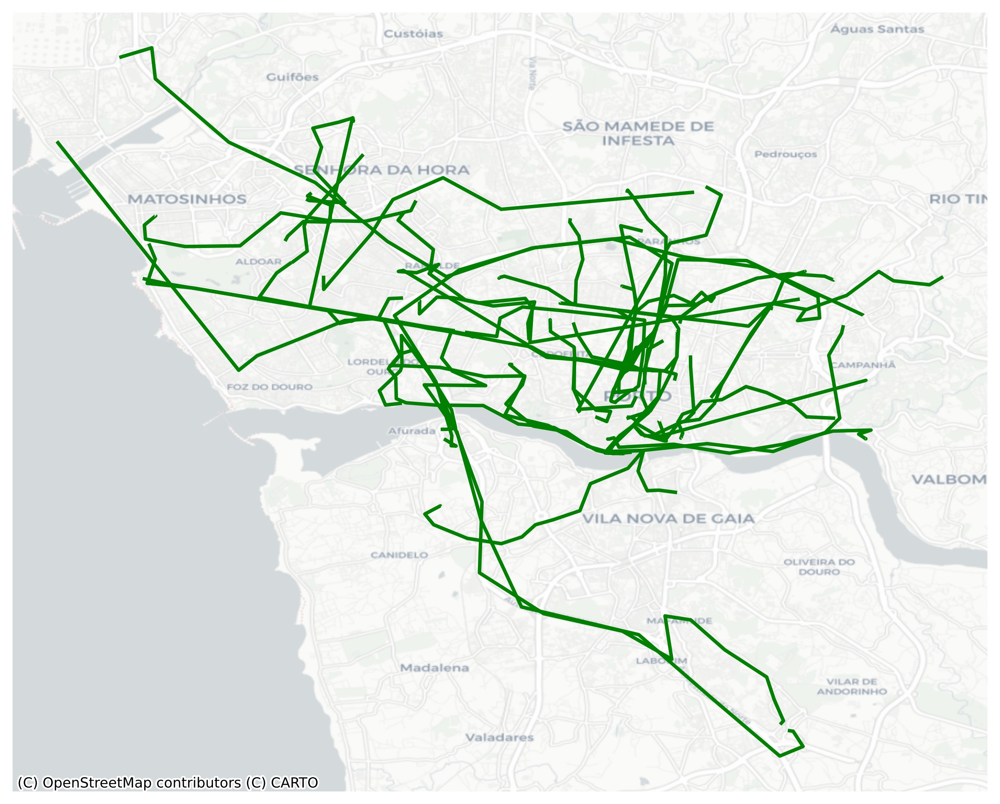

In [37]:
plot_map(partitions, 'green')

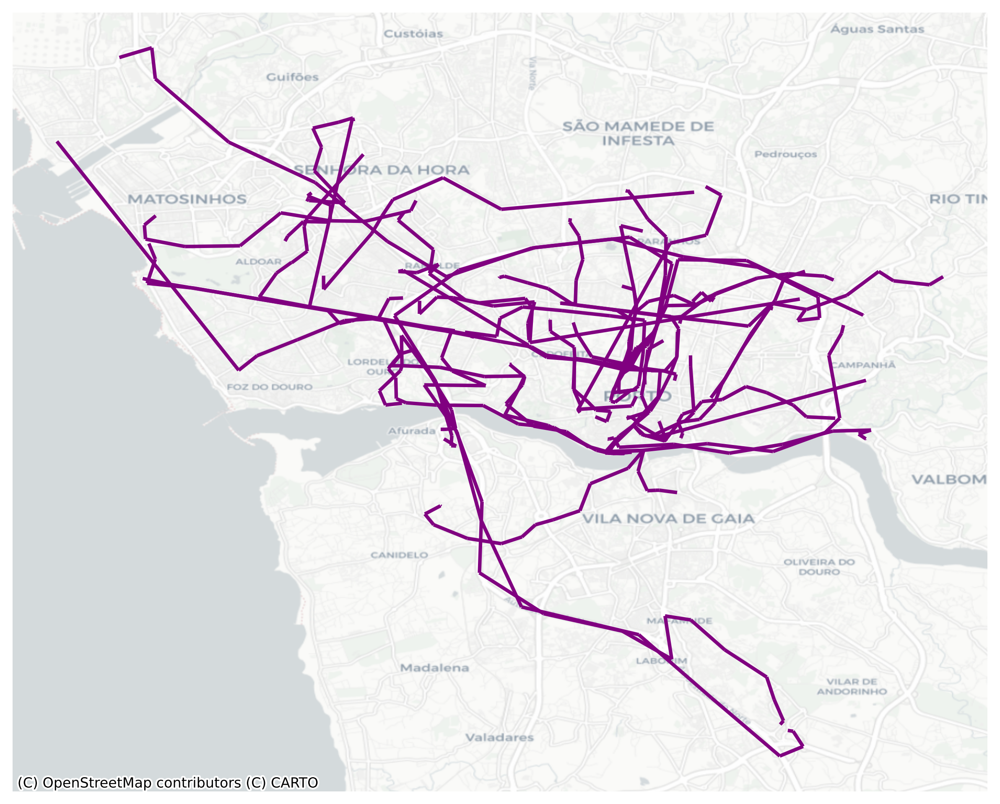

In [21]:
plot_map(segments, 'purple')

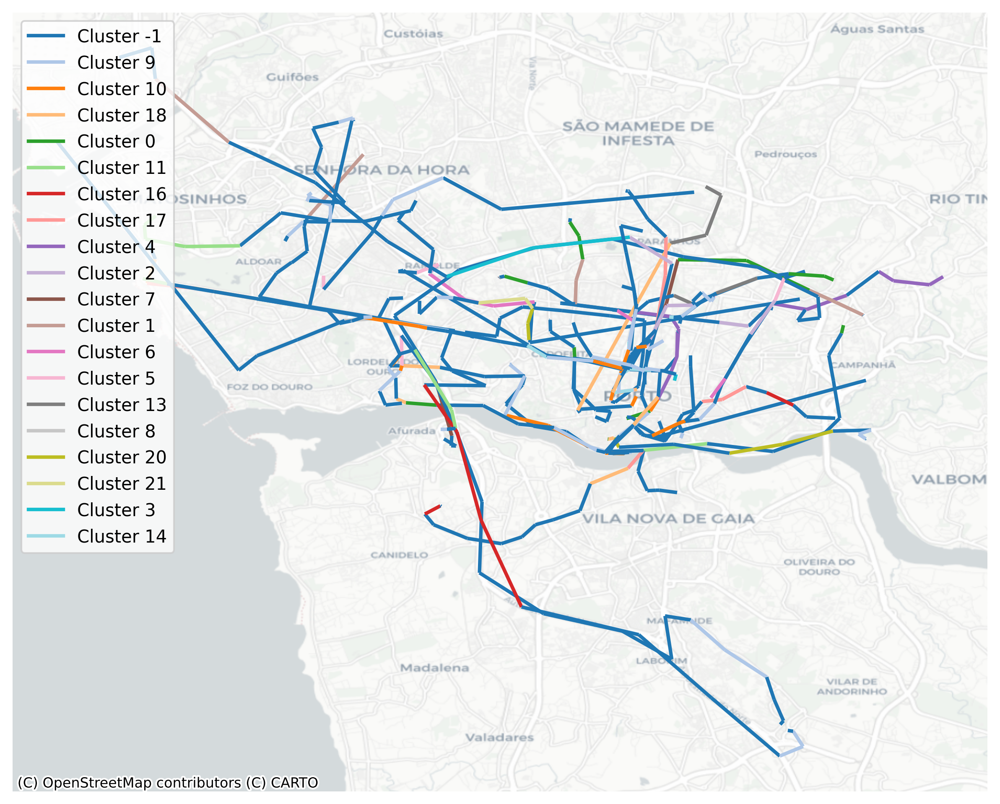

In [35]:
plot_clusters_on_map(clusters, cluster_assignments)

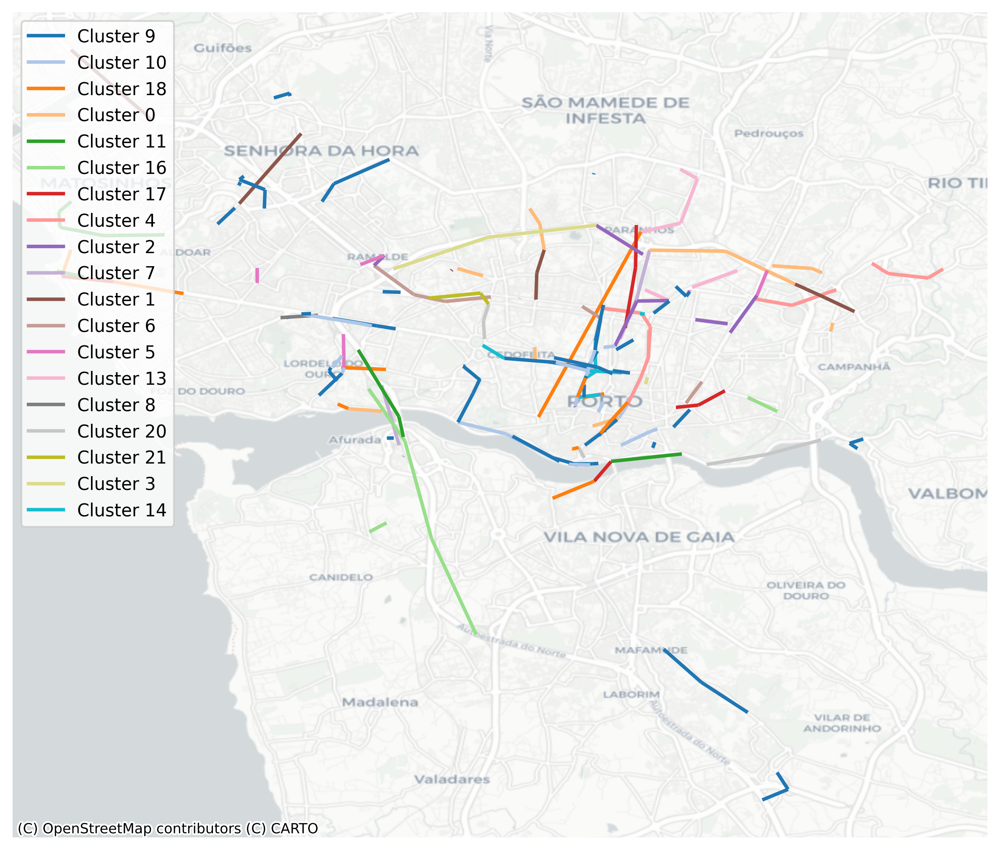

In [22]:
descart_minun_one = True
plot_clusters_on_map(clusters, cluster_assignments, descart_minun_one)

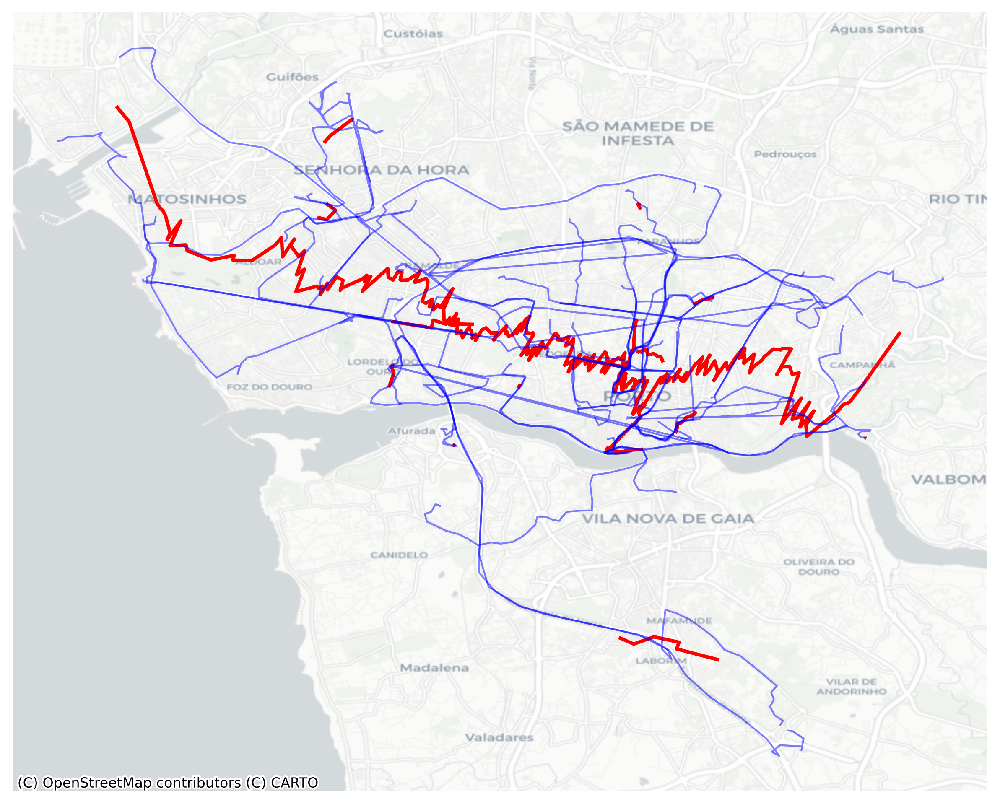

In [23]:
plot_map(representative_trajectories, 'red', df['POLYLINE'], 'blue')

Mostrar cada representacion del cluster con un color diferente

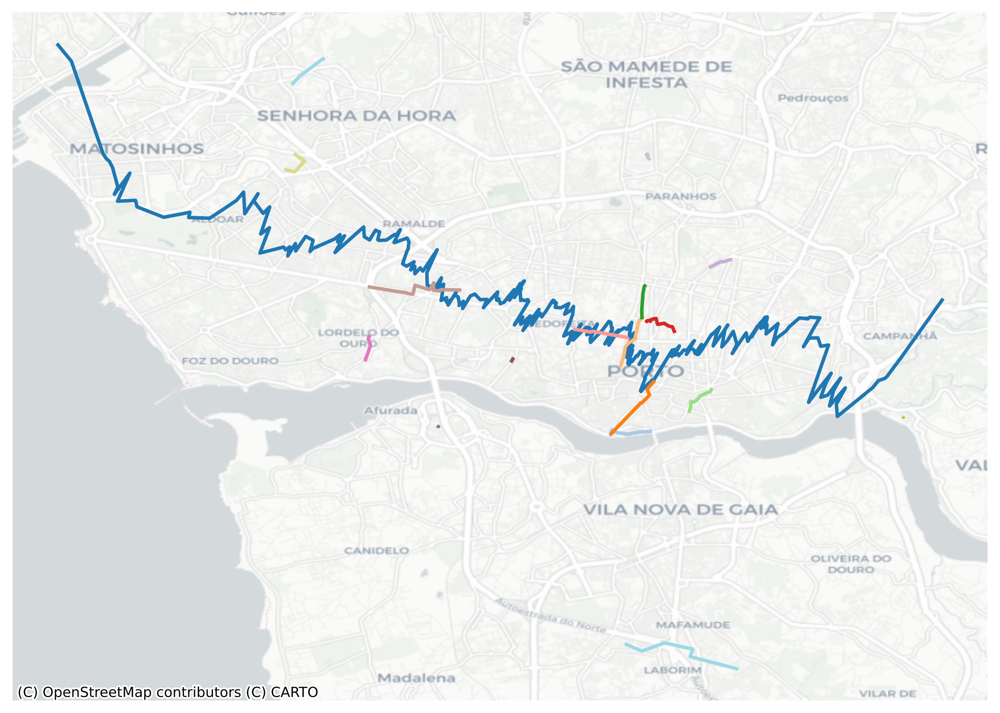

In [34]:
plot_representation_colour(representative_trajectories)

Implementacion de zoom que se puede usar

In [24]:
""" # Asegurarse de que los límites del eje se ajusten a las geometrías que estás mostrando
xmin, ymin, xmax, ymax = gdf.total_bounds
# Calcular el rango y expandirlo
xrange = xmax - xmin
yrange = ymax - ymin

# Aumentar el rango por un factor (por ejemplo, 20% más grande)
expand_factor = 100
xmin -= xrange * expand_factor
xmax += xrange * expand_factor
ymin -= yrange * expand_factor
ymax += yrange * expand_factor

# Aplicar los nuevos límites
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax) """

' # Asegurarse de que los límites del eje se ajusten a las geometrías que estás mostrando\nxmin, ymin, xmax, ymax = gdf.total_bounds\n# Calcular el rango y expandirlo\nxrange = xmax - xmin\nyrange = ymax - ymin\n\n# Aumentar el rango por un factor (por ejemplo, 20% más grande)\nexpand_factor = 100\nxmin -= xrange * expand_factor\nxmax += xrange * expand_factor\nymin -= yrange * expand_factor\nymax += yrange * expand_factor\n\n# Aplicar los nuevos límites\nax.set_xlim(xmin, xmax)\nax.set_ylim(ymin, ymax) '